In [30]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import transforms, datasets, models
from config import TRAIN_DIR, VALID_DIR, TEST_DIR
# import pandas as pd
import os
from shutil import copy2
from tqdm import tqdm


In [31]:
RANDOM_SEED = 42
torch.manual_seed(seed=RANDOM_SEED)
torch.cuda.manual_seed(seed=RANDOM_SEED)
np.random.seed(RANDOM_SEED)


In [45]:
# Marked json_s to xml_s files
# "imageData" property deleted from every json
'''
from dicttoxml import dicttoxml
import xmltodict
from json import load
import os

files = os.listdir("marked_frames")
for file in tqdm(files):
    if file in ["xml_s", "colored_frames"]: continue
    xml_file_name = "marked_frames/xml_s/" + file[:-4] + "xml"
    with open(f"marked_frames/{file}","r") as f:
        data = load(f)
        del data["imageData"]
        data = {"annotation": data}
        xml_file = open(xml_file_name,"w")
        xmltodict.unparse(data,output=xml_file)
        xml_file.close()
'''


100%|██████████| 503/503 [00:01<00:00, 269.93it/s]


In [34]:
# Shuffling files and create datasets
'''
all_data = np.array(os.listdir("marked_frames/colored_frames"))
np.random.seed(RANDOM_SEED)
np.random.shuffle(all_data)
# len = 502 then
train_filenames, valid_filenames, test_filenames = all_data[0:380], all_data[380:430], all_data[430:]
# print(train_filenames.shape, valid_filenames.shape, test_filenames.shape)

for png in train_filenames:
    xml = png[:-4] + '.xml'
    copy2(os.path.join("marked_frames/colored_frames",png), os.path.join(TRAIN_DIR,png))
    copy2(os.path.join("marked_frames/xml_s",xml), os.path.join(TRAIN_DIR,xml))

for png in valid_filenames:
    xml = png[:-4] + '.xml'
    copy2(os.path.join("marked_frames/colored_frames",png), os.path.join(VALID_DIR,png))
    copy2(os.path.join("marked_frames/xml_s",xml), os.path.join(VALID_DIR,xml))

for png in test_filenames:
    xml = png[:-4] + '.xml'
    copy2(os.path.join("marked_frames/colored_frames",png), os.path.join(TEST_DIR,png))
    copy2(os.path.join("marked_frames/xml_s",xml), os.path.join(TEST_DIR,xml))
'''


In [20]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device


'cuda'

In [46]:
train_dataset
valid_dataset
test_dataset


In [13]:
from xml.etree import ElementTree as et
import os
import glob as glob

tree = et.parse("D:/Education/10_sem/ml/hakaton/marked_frames/xml_s/frame_0700.xml")
root = tree.getroot()
boxes = []
labels = []
for member in root.findall('shapes'):
    # labels.append(self.classes.index(member.find('name').text))
    lb = member.find('label').text
    if lb != 'sling': continue
    print(''.join(m.text for m in member.findall('points')))
    


[786.4047936085219, 0.0][833.2304038004751, 103.56294536817103]
[782.5636007827788, 0.0][796.6508313539192, 133.729216152019]
[780.0133155792277, 0.0][724.2210386151797, 116.37816245006658]
[783.4753661784288, 0.3994673768308922][766.1651131824234, 87.21704394141145]


In [15]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)
# model.eval()


Using cache found in C:\Users\SOBAKA/.cache\torch\hub\ultralytics_yolov5_master


requirements: Ultralytics requirements ['gitpython>=3.1.30', 'pillow>=10.3.0'] not found, attempting AutoUpdate...

requirements: AutoUpdate success  3.3s, installed 2 packages: ['gitpython>=3.1.30', 'pillow>=10.3.0']
requirements:  Restart runtime or rerun command for updates to take effect



YOLOv5  2024-4-13 Python-3.11.5 torch-2.2.2 CUDA:0 (NVIDIA GeForce RTX 2080 Ti, 11264MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


In [16]:
model_total_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f'Number of trainable parameters: {model_total_params}')
# parameters
# small:        7225885
# nano:         1867405
# yolop:        7940846


Number of trainable parameters: 0


In [17]:
model.eval()
imgs = [
    # 'http://images.cocodataset.org/val2017/000000397133.jpg',
    # 'http://images.cocodataset.org/val2017/000000037777.jpg',
    # 'http://images.cocodataset.org/val2017/000000252219.jpg'
    'frames_to_be_marked/frame_0400.png',
    'frames_to_be_marked/frame_0410.png',
    'frames_to_be_marked/frame_0420.png',
    'frames_to_be_marked/frame_0430.png',
    'frames_to_be_marked/frame_0440.png',
    'frames_to_be_marked/frame_0450.png',
    'frames_to_be_marked/frame_0460.png',
    'frames_to_be_marked/frame_0470.png',
    'frames_to_be_marked/frame_0480.png',
    'frames_to_be_marked/frame_0490.png',
    'frames_to_be_marked/frame_0500.png',
    'frames_to_be_marked/frame_0510.png',
    'frames_to_be_marked/frame_0520.png',
    'frames_to_be_marked/frame_0530.png',
    'frames_to_be_marked/frame_0540.png',
    'frames_to_be_marked/frame_0550.png',
    'frames_to_be_marked/frame_0560.png'
]


In [18]:
results = model(imgs)
# img = torch.randn(1,3,640,640)
# det_out, da_seg_out,ll_seg_out = model(img)


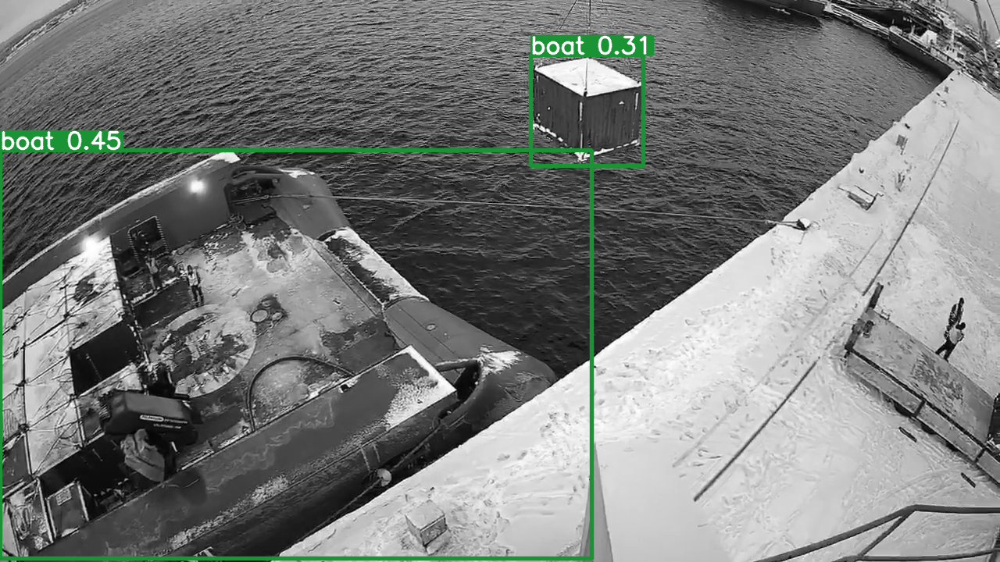

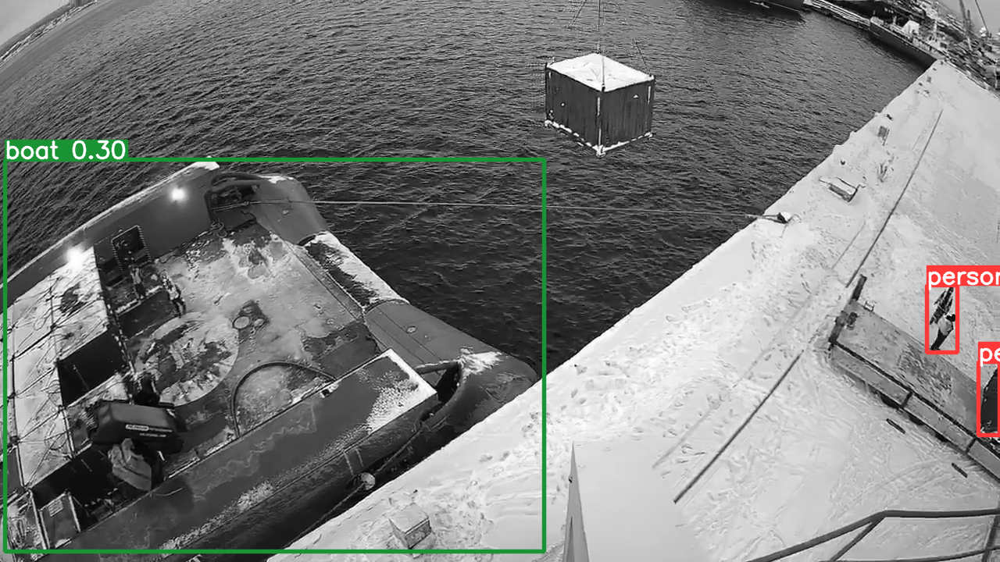

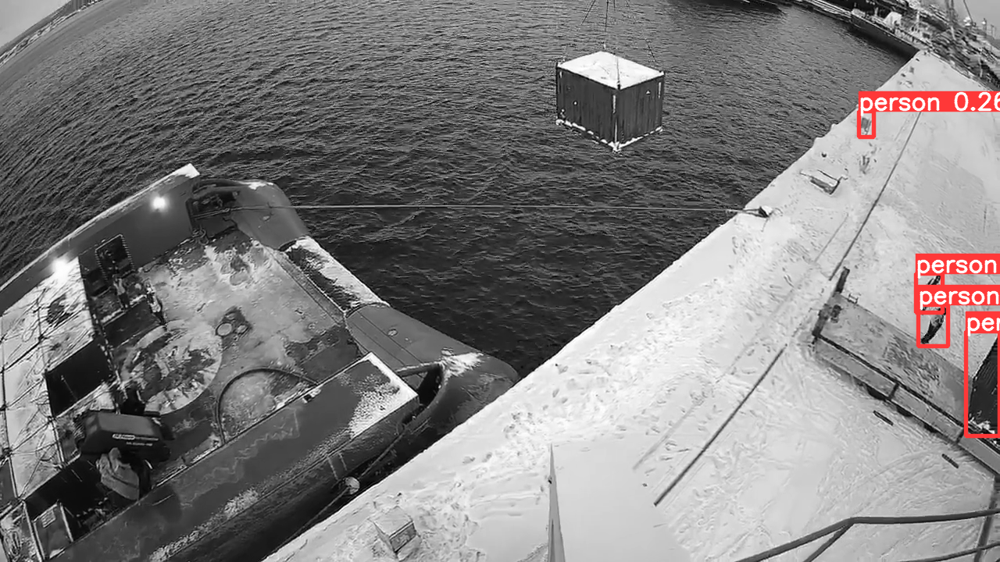

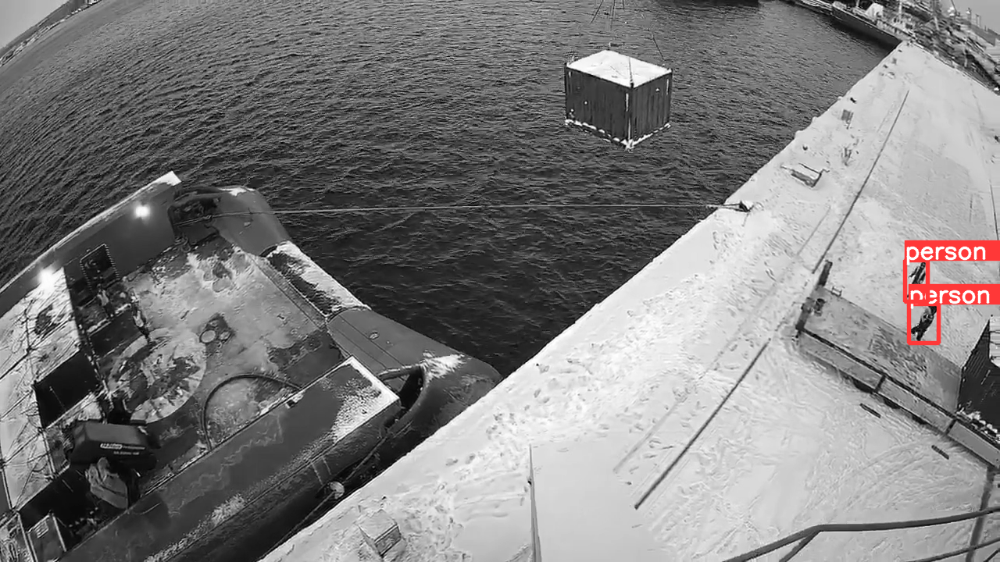

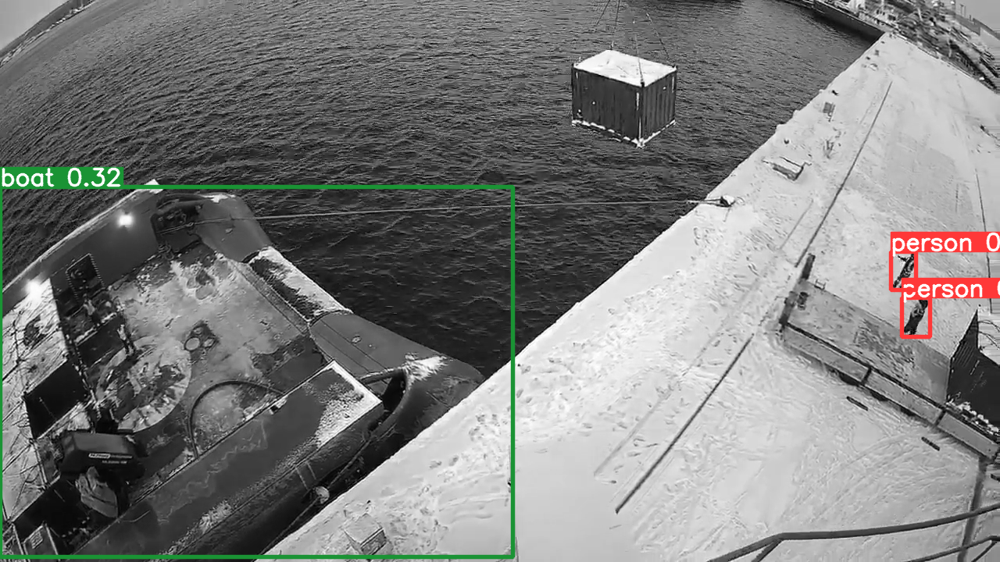

...

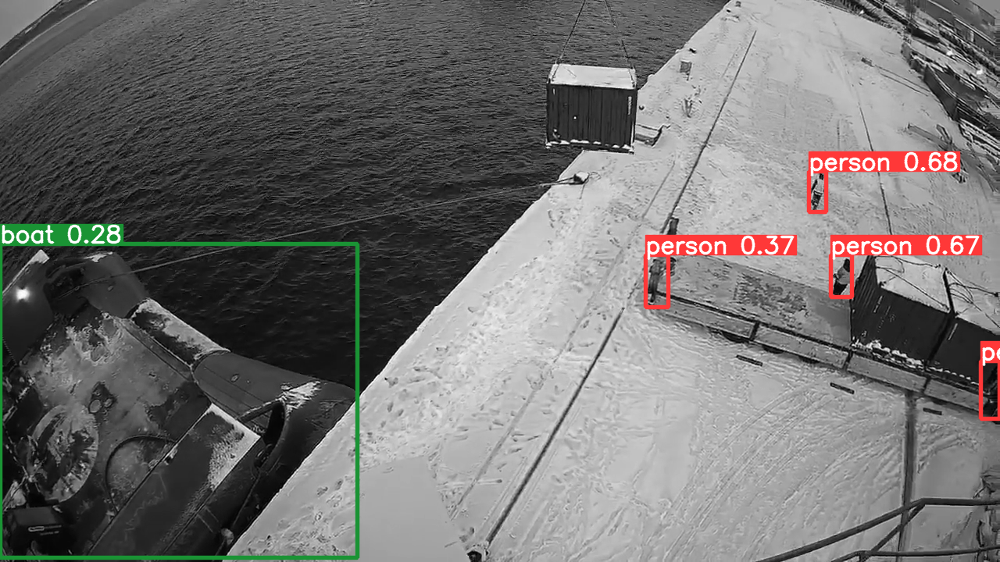

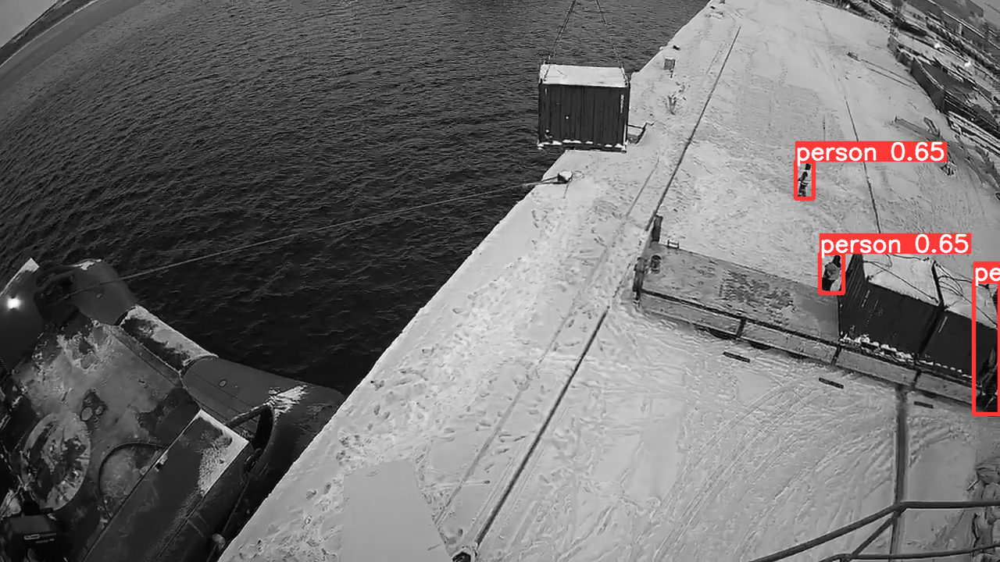

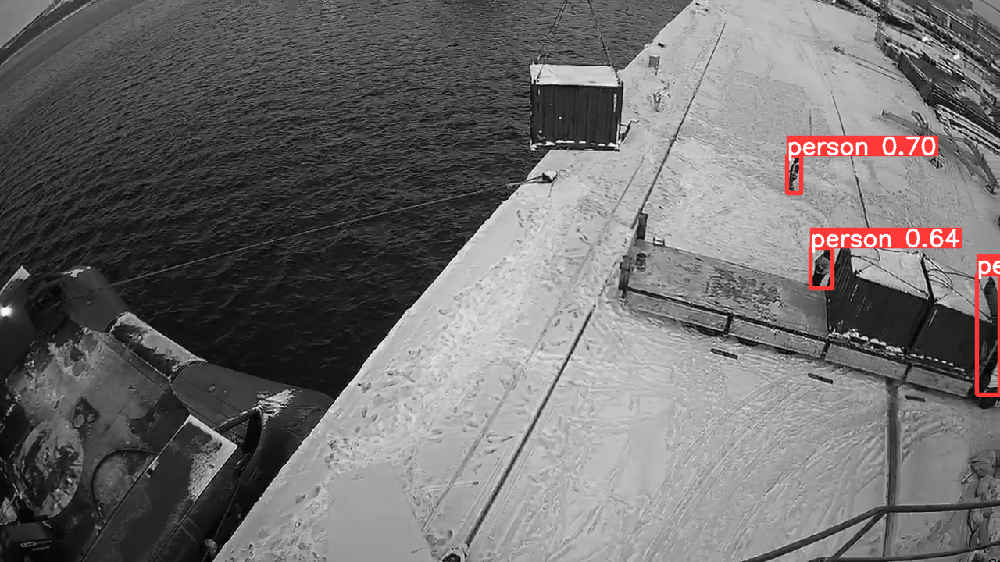

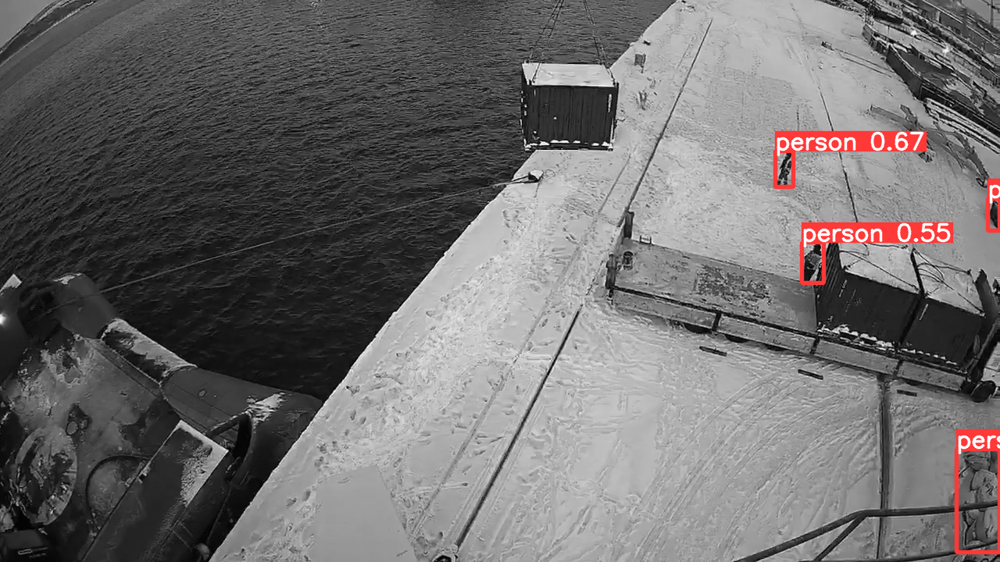

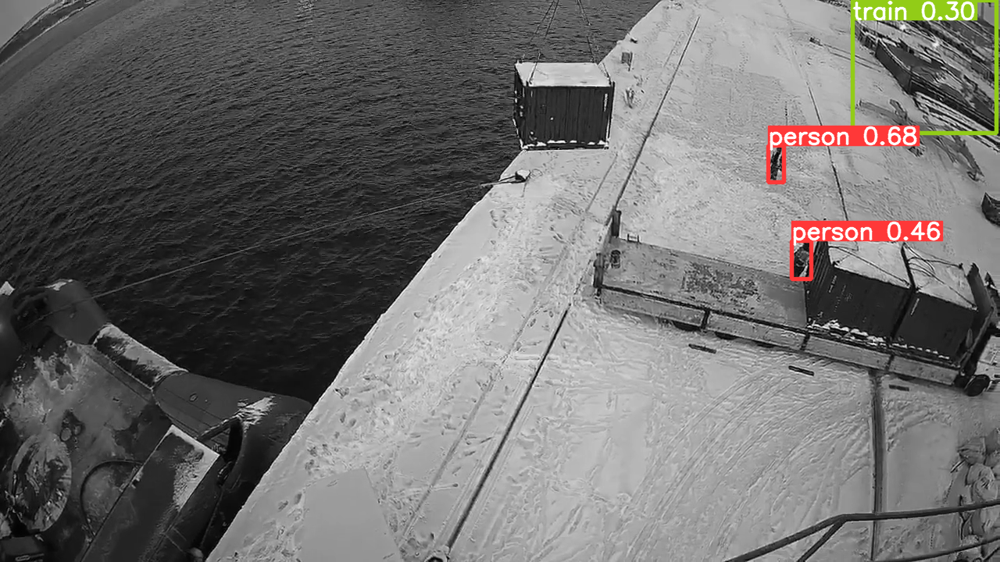

In [19]:
results.show()
